# Setup

## Install Detectron2

In [2]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
# !git clone 'https://github.com/facebookresearch/detectron2'
# dist = distutils.core.run_setup("./detectron2/setup.py")
# !python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
# sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 274 kB 5.9 MB/s eta 0:00:01
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44074 sha256=fcd41c930a264b23cdf49613f434121cd6af53d2e1ae96dd10c78e61a91f9ec0
  Stored in directory: /home/shabanza/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.7.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Defaulting to user installation because normal site-packages is not writeable
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-gt3u6e46
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-gt3u6e46
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 5.5 MB 11.3 MB/s eta 0:00:01
     |████████████████████████████████| 50 kB 25.3 MB/s eta 0:00:01
     |████████████████████████████████| 79 kB 28.3 MB/s eta 0:00:01
     |████████████████████████████████| 154 kB 142.4 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 87.9 MB/s et

In [1]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Mon_May__3_19:15:13_PDT_2021
Cuda compilation tools, release 11.3, V11.3.109
Build cuda_11.3.r11.3/compiler.29920130_0
torch:  1.10 ; cuda:  cu113
detectron2: 0.6


## Install Mask2Former

In [2]:
# clone and install Mask2Former
# !git clone https://github.com/facebookresearch/Mask2Former.git
%cd Mask2Former
%pip install -U opencv-python
# %pip install git+https://github.com/cocodataset/panopticapi.git
%pip install -r requirements.txt
%cd mask2former/modeling/pixel_decoder/ops
!python setup.py build install

/scratch/shabanza/segmentation/Mask2Former
Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 61.7 MB 6.0 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable


     |████████████████████████████████| 2.3 MB 6.1 MB/s eta 0:00:01
     |████████████████████████████████| 2.2 MB 120.5 MB/s eta 0:00:01
     |████████████████████████████████| 73 kB 9.5 MB/s s eta 0:00:01
     |████████████████████████████████| 1.3 MB 110.5 MB/s eta 0:00:01
     |████████████████████████████████| 268 kB 96.6 MB/s eta 0:00:01
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  NOTE: The current PATH contains path(s) starting with `~`, which may not be expanded by all applications.
Note: you may need to restart the kernel to use updated packages.
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing n

In [3]:
%cd /scratch/shabanza/segmentation/Mask2Former
%cd mask2former/modeling/pixel_decoder/ops
!sudo sh make.sh
%cd /scratch/shabanza/segmentation/Mask2Former

/scratch/shabanza/segmentation/Mask2Former
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops
running build
running build_py
running build_ext
building 'MultiScaleDeformableAttention' extension
Emitting ninja build file /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/build.ninja...
Compiling objects...
Allowing ninja to set a default number of workers... (overridable by setting the environment variable MAX_JOBS=N)
ninja: no work to do.
g++ -pthread -shared -B /opt/conda/compiler_compat -L/opt/conda/lib -Wl,-rpath=/opt/conda/lib -Wl,--no-as-needed -Wl,--sysroot=/ /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/src/vision.o /scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/pixel_decoder/ops/build/temp.linux-x86_64-3.8/scratch/shabanza/segment

Adding MultiScaleDeformableAttention 1.0 to easy-install.pth file

Installed /opt/conda/lib/python3.8/site-packages/MultiScaleDeformableAttention-1.0-py3.8-linux-x86_64.egg
Processing dependencies for MultiScaleDeformableAttention==1.0
Finished processing dependencies for MultiScaleDeformableAttention==1.0
/scratch/shabanza/segmentation/Mask2Former


For gccxx not found error:
> sudo apt-get update

> sudo apt-get install software-properties-common

> sudo add-apt-repository ppa:ubuntu-toolchain-r/test

> sudo apt-get upgrade libstdc++6

For libGL error:
> sudo apt-get install ffmpeg libsm6 libxext6  -y

## Imports

In [2]:
# import some common libraries
import os
import cv2
import json
import torch
import random
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image, ImageDraw
from IPython.display import display
from IPython.display import Image as dis_image

from detectron2.utils.visualizer import Visualizer

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
torch.cuda.empty_cache()

In [5]:
# You may need to restart your runtime prior to this, to let your installation take effect
%cd Mask2Former
# Some basic setup:
# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()
setup_logger(name="mask2former")


# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.projects.deeplab import add_deeplab_config
coco_metadata = MetadataCatalog.get("coco_2017_val_panoptic")

# import Mask2Former project
from mask2former import add_maskformer2_config

/scratch/shabanza/segmentation/Mask2Former


# Model

In [6]:
cfg = get_cfg()
add_deeplab_config(cfg)
add_maskformer2_config(cfg)
cfg.merge_from_file("configs/coco/instance-segmentation/swin/maskformer2_swin_large_IN21k_384_bs16_100ep.yaml")
cfg.MODEL.WEIGHTS = 'https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl'

cfg.MODEL.MASK_FORMER.TEST.SEMANTIC_ON = True
cfg.MODEL.MASK_FORMER.TEST.INSTANCE_ON = True
cfg.MODEL.MASK_FORMER.TEST.PANOPTIC_ON = True
predictor = DefaultPredictor(cfg)

/opt/conda/lib/python3.8/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/15 14:19:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/maskformer/mask2former/coco/instance/maskformer2_swin_large_IN21k_384_bs16_100ep/model_final_e5f453.pkl ...
WARNING [08/15 14:19:09 mask2former.modeling.transformer_decoder.mask2former_transformer_decoder]: Weight format of MultiScaleMaskedTransformerDecoder have changed! Please upgrade your models. Applying automatic conversion now ...


# Dataset

In [7]:
from detectron2.data import DatasetCatalog, MetadataCatalog
from src.dataset.register_comic_instance import *

In [8]:
dataset_name = DATASET_NAME

dataset_dicts = DatasetCatalog.get(dataset_name)
metadata = MetadataCatalog.get(dataset_name)

[08/15 14:19:24 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default_modified.json takes 1.72 seconds.
[08/15 14:19:24 d2.data.datasets.coco]: Loaded 282 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_default_modified.json


In [9]:
placid_dataset_dicts = DatasetCatalog.get(PLACID_NAME)
placid_metadata = MetadataCatalog.get(PLACID_NAME)

[08/15 14:19:26 d2.data.datasets.coco]: Loading /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_placid.json takes 1.37 seconds.
[08/15 14:19:26 d2.data.datasets.coco]: Loaded 154 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_placid.json


In [10]:
yves_dataset_dicts = DatasetCatalog.get(YVES_NAME)
yves_metadata = MetadataCatalog.get(YVES_NAME)

[08/15 14:19:27 d2.data.datasets.coco]: Loaded 128 images in COCO format from /sinergia/shabanza/datasets/sinergia/coco/annotations/instances_yves.json


## Visualize Samples

In [17]:
from src.dataset.helpers import visualize_sample_anns, visualize_dataset_dict

In [24]:
sample = random.choice(placid_dataset_dicts)
image = cv2.imread(sample["file_name"])

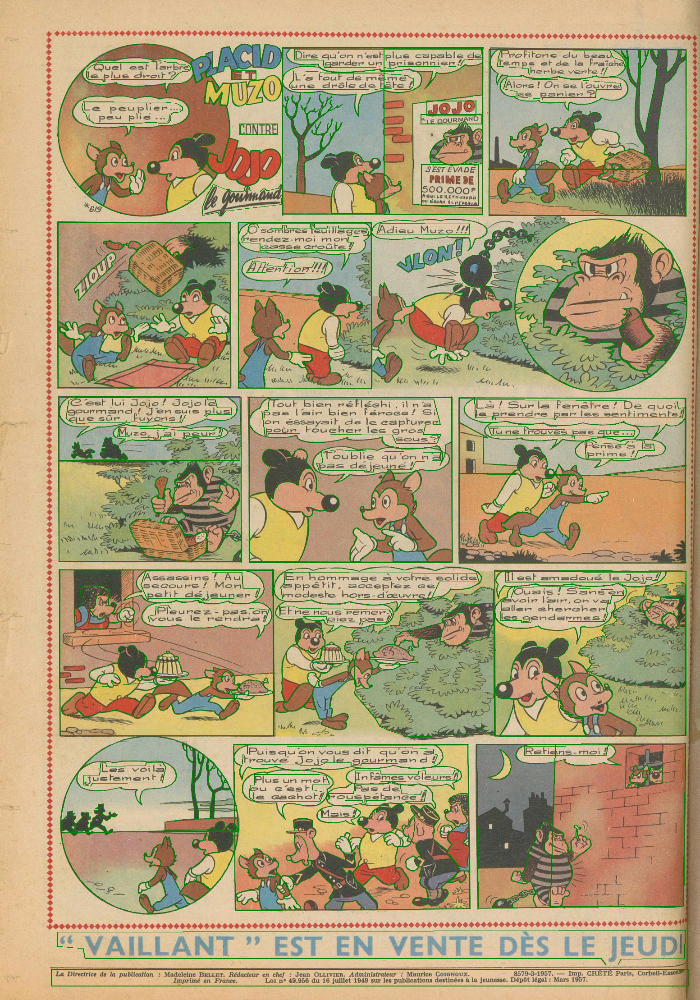

In [23]:
visualize_sample_anns(sample)

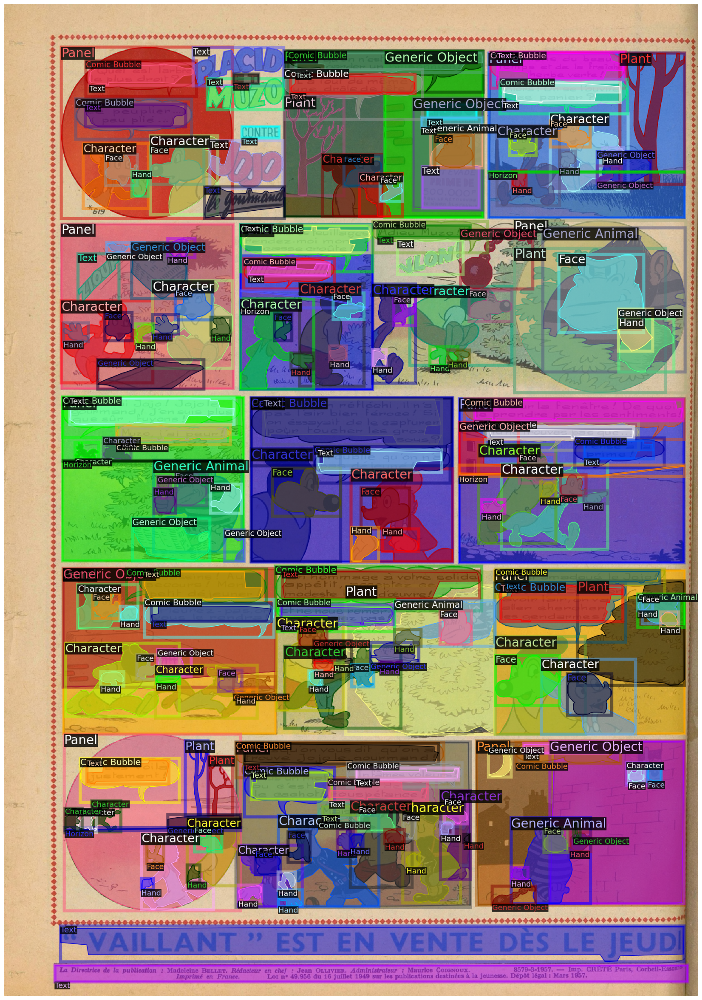

In [24]:
visualize_dataset_dict(sample, placid_metadata)

## Visualize Model Outputs

In [22]:
# Show panoptic/instance/semantic predictions

def show_seg_predictions(im, outputs, metadata):
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    panoptic_result = v.draw_panoptic_seg(outputs["panoptic_seg"][0].to("cpu"), outputs["panoptic_seg"][1]).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    v = Visualizer(im[:, :, ::-1], metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    semantic_result = v.draw_sem_seg(outputs["sem_seg"].argmax(0).to("cpu")).get_image()
    print("Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)")
    res = np.concatenate((panoptic_result, instance_result, semantic_result), axis=0)[:, :, ::-1]
    plt.figure(figsize=(40, 30))
    plt.imshow(res)
    plt.axis('off')
    plt.show()

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


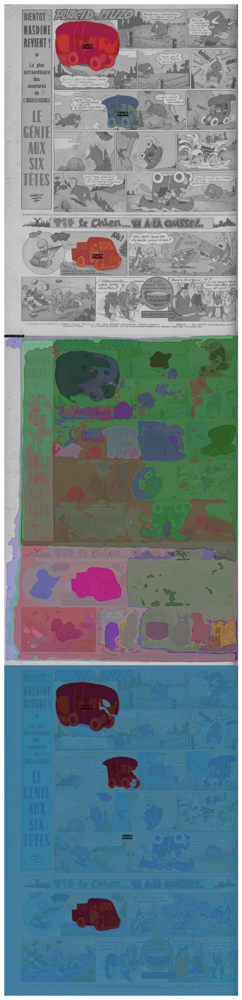

In [26]:
sample = random.choice(placid_dataset_dicts)
im = cv2.imread(sample["file_name"])
outputs = predictor(im)
show_seg_predictions(im, outputs, coco_metadata)

In [27]:
sample

{'file_name': '/sinergia/shabanza/datasets/sinergia/images/default/placid/Vaillant_0539_1955_09_11-16.png',
 'height': 2230,
 'width': 1584,
 'image_id': 222,
 'annotations': [{'iscrowd': 0,
   'bbox': [1128.18, 1642.95, 179.54, 136.34],
   'category_id': 0,
   'segmentation': [[1128.18,
     1685.46,
     1189.35,
     1663.34,
     1193.5,
     1663.0,
     1192.81,
     1659.54,
     1271.95,
     1642.95,
     1281.28,
     1652.11,
     1281.97,
     1657.64,
     1307.72,
     1683.22,
     1259.68,
     1736.44,
     1196.27,
     1774.63,
     1191.77,
     1773.59,
     1191.43,
     1779.12,
     1171.56,
     1779.29,
     1171.04,
     1748.19,
     1134.23,
     1707.06,
     1137.34,
     1703.09,
     1132.68,
     1702.92]],
   'bbox_mode': <BoxMode.XYWH_ABS: 1>},
  {'iscrowd': 0,
   'bbox': [1163.24, 1290.11, 28.8, 31.5],
   'category_id': 22,
   'segmentation': [[1170.24,
     1320.51,
     1168.64,
     1319.91,
     1167.04,
     1318.71,
     1165.64,
     1317.31,

## Test with Panel Extracted

In [26]:
from src.dataset.helpers import get_panels

In [27]:
im = cv2.imread(sample["file_name"])
panels, _ = get_panels(sample)

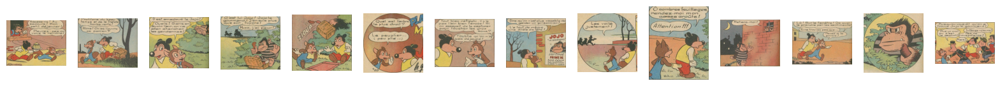

In [28]:
fig, axes = plt.subplots(1, len(panels), figsize=(20, 10))
for i, panel in enumerate(panels):
    axes[i].imshow(panel)
    axes[i].axis('off')

plt.show()

/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  dim_t = self.temperature ** (2 * (dim_t // 2) / self.num_pos_feats)
/scratch/shabanza/segmentation/Mask2Former/mask2former/modeling/transformer_decoder/position_encoding.py:41: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use 

Panoptic segmentation (top), instance segmentation (middle), semantic segmentation (bottom)


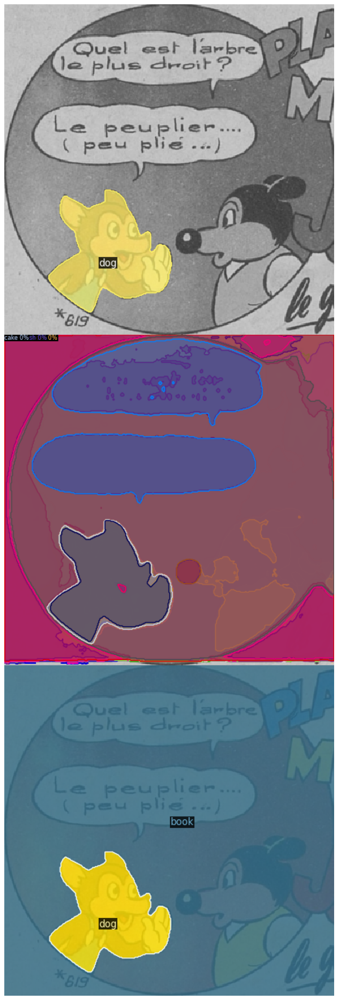

In [29]:
# Show panoptic/instance/semantic predictions

show_seg_predictions(panels[5], predictor(panels[5]), coco_metadata)

# Evaluation

In [11]:
import warnings
warnings.filterwarnings('ignore')

In [11]:
import seaborn as sns

def plot_confusion_matrix(confusion_matrix, labels):
    plt.figure(figsize=(20, 20))
    sns.heatmap(confusion_matrix, annot=True, cmap="Blues", fmt="d", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.title("Confusion Matrix")
    plt.show()

### Page-Wise

In [12]:
from src.evaluation.instance_evaluation import *
from src.evaluation.helpers import *
from src.dataset.register_comic_instance import COMIC_CLASS_ID2CATEGORY

#### placid

In [33]:
evaluator = ComicInstanceEvaluator(PLACID_NAME)

In [34]:
im = cv2.imread(sample['file_name'])
outputs = predictor(im)

In [35]:
evaluator.process([sample], [outputs])
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0019387693707831318
iou_per_class:
Generic Object: 0.035699328913560924
Car: 0.014377119603724647
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.00045690831520529585
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.003752185549436821


In [13]:
evaluator = ComicInstanceEvaluator(PLACID_NAME)

In [14]:
for sample in tqdm(placid_dataset_dicts[:50]):
    im = cv2.imread(sample['file_name'])
    outputs = predictor(im)
    evaluator.process([sample], [outputs])

100%|██████████| 50/50 [25:23<00:00, 30.47s/it]


In [15]:
metrics = evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0020970827903940632
iou_per_class:
Generic Object: 0.03568628606952978
Car: 0.0002909384784222491
Bus: 0.0
Bicycle: 0.0
Motorbike: 6.366844923333279e-06
Airplane: 0.0
Boat: 0.0009119004867063856
Train: 0.0
Chair: 0.00011185652988021742
Sofa: 2.3516861431386235e-05
Table: 0.000284674588159016
Plant: 0.0
Cat: 0.0003082359874924854
Dog: 0.0003014823859300534
Cow: 1.0544167363968035e-06
Horse: 0.0
Sheep: 0.0
Bird: 0.00015795554267150294
Generic Animal: 0.001017494789371493
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.019616555149779474


#### yves

In [21]:
evaluator2 = ComicInstanceEvaluator(YVES_NAME)

In [22]:
evaluate_page_wise(evaluator2, predictor, yves_dataset_dicts)

[08/15 13:26:32 d2.utils.memory]: Attempting to copy inputs of <bound method MaskFormer.semantic_inference of MaskFormer(
  (backbone): D2SwinTransformer(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 192, kernel_size=(4, 4), stride=(4, 4))
      (norm): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
    )
    (pos_drop): Dropout(p=0.0, inplace=False)
    (layers): ModuleList(
      (0): BasicLayer(
        (blocks): ModuleList(
          (0): SwinTransformerBlock(
            (norm1): LayerNorm((192,), eps=1e-05, elementwise_affine=True)
            (attn): WindowAttention(
              (qkv): Linear(in_features=192, out_features=576, bias=True)
              (attn_drop): Dropout(p=0.0, inplace=False)
              (proj): Linear(in_features=192, out_features=192, bias=True)
              (proj_drop): Dropout(p=0.0, inplace=False)
              (softmax): Softmax(dim=-1)
            )
            (drop_path): Identity()
            (norm2): LayerNorm((192,), eps=1e-05

KeyboardInterrupt: 

In [23]:
metrics = evaluator2.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0026549330436267194
iou_per_class:
Generic Object: 0.03493646757989524
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0052624682590712655
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.03413918938258164


### Panel-Wise

#### placid

In [30]:
# Instance
panel_evaluator = ComicInstanceEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
panels, cropped_boxes = get_panels(sample)
for panel, cropped_box in tqdm(zip(panels, cropped_boxes)):
    outputs = predictor(panel)
    evaluator.process([sample], [outputs], cropped_box=cropped_box)
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

22it [1:02:32, 170.59s/it]

mean_iou 0.0
iou_per_class:
Generic Object: 0.0
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0
Sofa: 0.0
Table: 0.0
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.0
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.0


In [31]:
# Semantic
panel_evaluator = ComicSemanticEvaluator(PLACID_NAME)
im = cv2.imread(sample['file_name'])
outputs = predictor(im)
panels, cropped_boxes = get_panels(sample)
for panel, cropped_box in tqdm(zip(panels, cropped_boxes)):
    outputs = predictor(panel)
    evaluator.process([sample], [outputs], cropped_box=cropped_box)
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

NameError: name 'ComicSemanticEvaluator' is not defined

In [18]:
panel_evaluator = ComicInstanceEvaluator(PLACID_NAME)
evaluate_panel_wise(panel_evaluator, predictor, placid_dataset_dicts[:50])

KeyboardInterrupt: 

In [19]:
metrics = panel_evaluator.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0023704668504285946
iou_per_class:
Generic Object: 0.03564147807252645
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0008861416347828899
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 9.760249652669012e-05
Sofa: 0.0
Table: 0.00011973545124638256
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 2.4726689842577278e-05
Horse: 0.0039209069127506295
Sheep: 0.0
Bird: 0.0011602346096456515
Generic Animal: 9.786213954921123e-06
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.024512459730724464


#### yves

In [26]:
panel_evaluator2 = ComicInstanceEvaluator(PLACID_NAME)

In [27]:
evaluate_panel_wise(panel_evaluator2, predictor, placid_dataset_dicts)

KeyboardInterrupt: 

In [29]:
metrics = panel_evaluator2.evaluate()
print("mean_iou", metrics["mean_iou"])
print("iou_per_class:")
for class_id, iou in metrics["iou_per_class"].items():
    print(f"{COMIC_CLASS_ID2CATEGORY[class_id + 1]}: {iou}")

mean_iou 0.0030701802554291926
iou_per_class:
Generic Object: 0.03561760980255012
Car: 0.0
Bus: 0.0
Bicycle: 0.0
Motorbike: 0.0
Airplane: 0.0
Boat: 0.0
Train: 0.0
Chair: 0.0011365269250323174
Sofa: 0.0
Table: 0.0031451922544447034
Plant: 0.0
Cat: 0.0
Dog: 0.0
Cow: 0.0
Horse: 0.0
Sheep: 0.0
Bird: 0.02361175260904566
Generic Animal: 0.0
Building: 0.0
Background: 0.0
Face: 0.0
Hand: 0.0
Horizon: 0.0
Panel: 0.0
Comic Bubble: 0.0
Text: 0.0
Character: 0.022453965560944596


### Visualize Samples

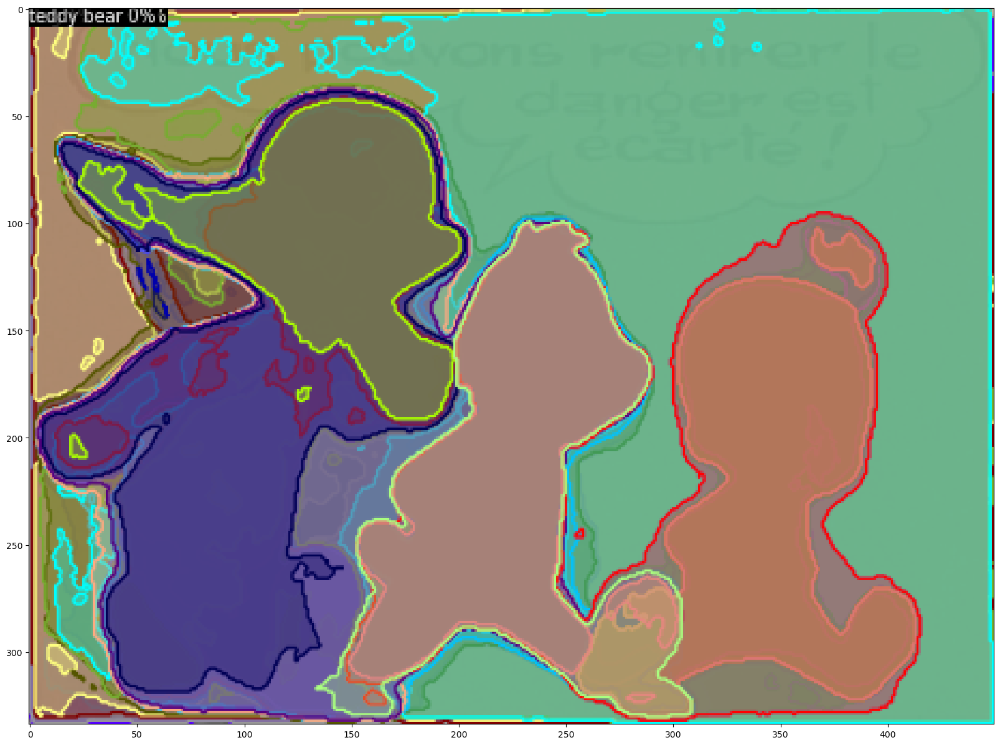

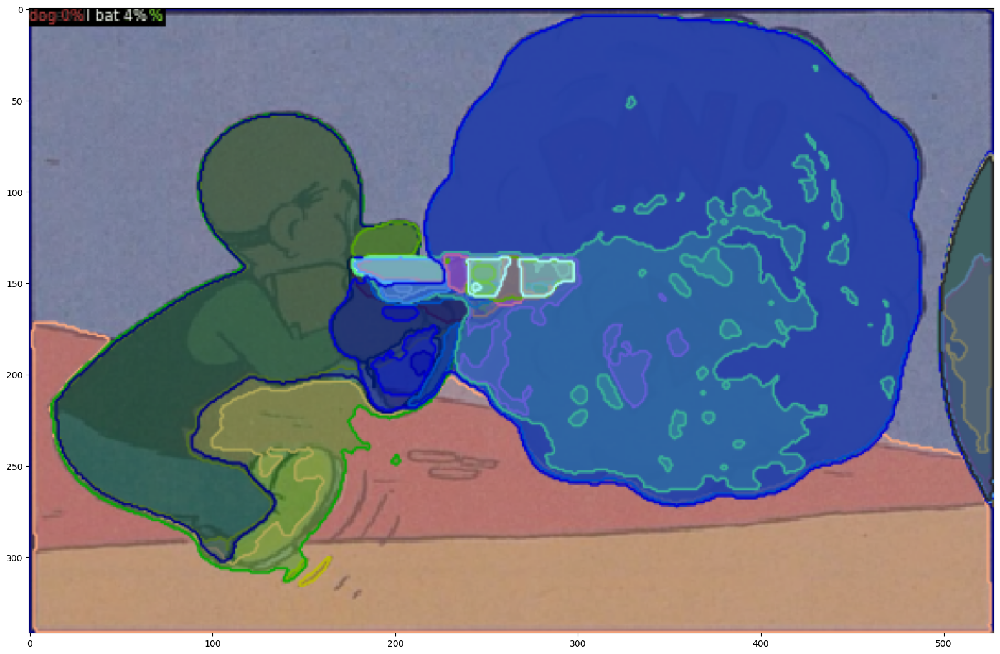

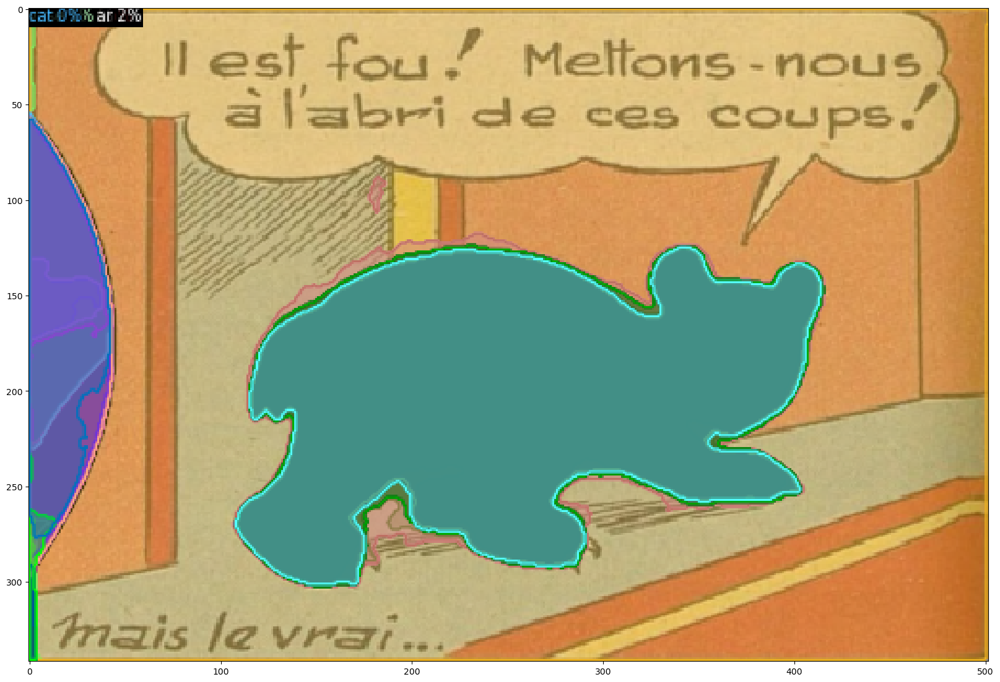

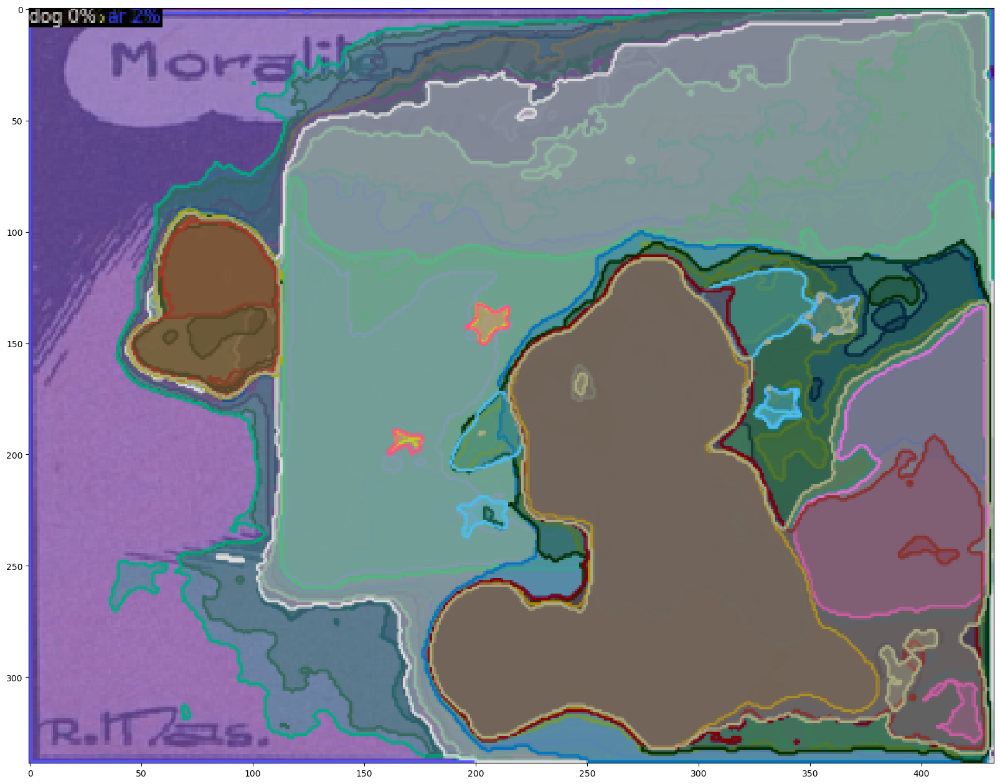

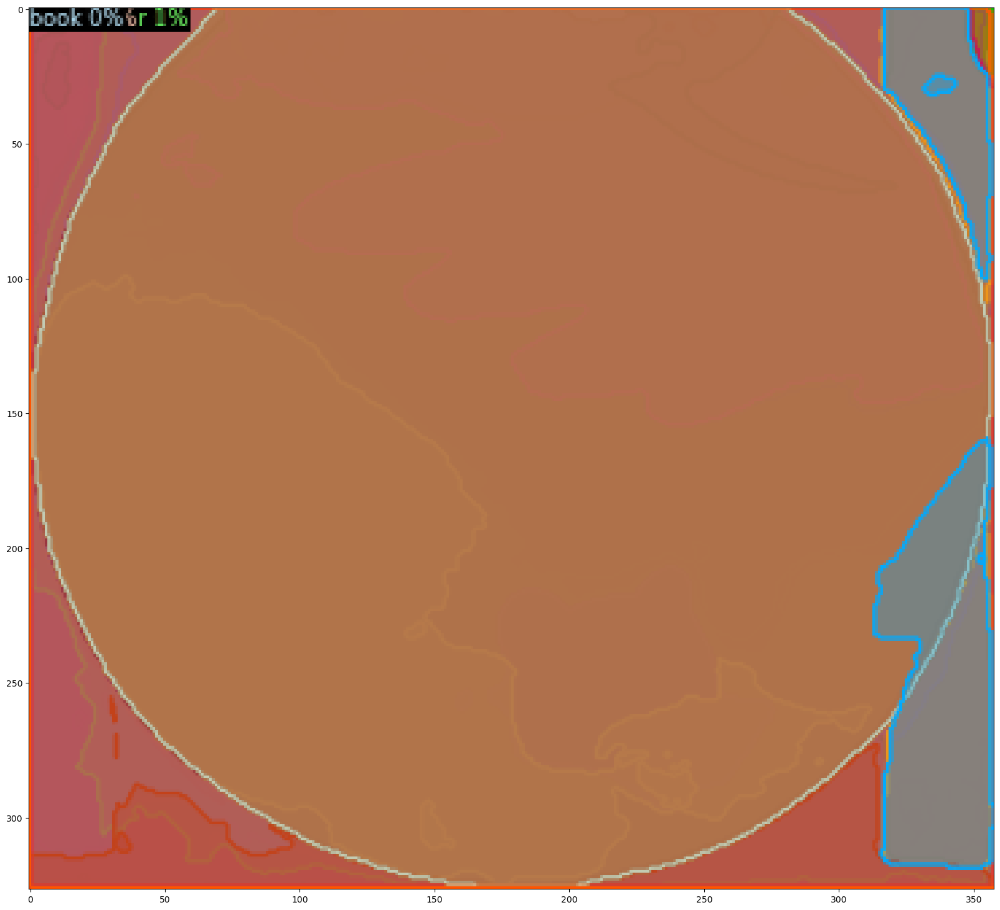

In [72]:
im = cv2.imread(sample["file_name"])
panelsو_ = get_panels(sample)
for panel in panels:
    outputs = predictor(panel)
    v = Visualizer(panel, coco_metadata, scale=1.2, instance_mode=ColorMode.IMAGE_BW)
    instance_result = v.draw_instance_predictions(outputs["instances"].to("cpu")).get_image()
    plt.figure(figsize=(20, 20))
    plt.imshow(instance_result)
    plt.show()